In [2]:
%matplotlib inline
import os
import numpy as np
import xarray as xr
import pandas as pd
import netCDF4 as nc
import rioxarray as rxr
from concurrent.futures import ThreadPoolExecutor
import warnings
import geopandas as gpd
from pylab import rcParams
# import seaborn as sns
import matplotlib
import matplotlib.pyplot as plt
import matplotlib.colors as colors
import matplotlib.ticker as ticker
import matplotlib.patches as patches
import matplotlib.font_manager as fm
from matplotlib.gridspec import GridSpec
import cartopy.crs as ccrs
import cartopy.feature as cfeature
from cartopy.mpl.ticker import LongitudeFormatter, LatitudeFormatter
from pathlib import Path

In [10]:
#### Here we set the configuration
RES = "p05"
NOTEBOOK_DIR = Path().resolve()
ROOT_DIR = (NOTEBOOK_DIR / "../data").resolve()
RUN_DIR = ROOT_DIR / 'run'
SHP_DIR = ROOT_DIR / 'Shp'
region = [-180,180,-60,90]

In [68]:
def load_and_flatten_data(name, var, path, index=None):
    try:
        with nc.Dataset(f"{RUN_DIR}/{path}/{name}.nc") as dataset:
            data = dataset[var][index, :, :].flatten() if index is not None else dataset[var][:, :].flatten()
        return data
    except Exception as e:
        warnings.warn(f"Error loading {name}.nc or variable {var}: {e}")
        return None

def load_lat_lon():
    try:
        with nc.Dataset(f"{RUN_DIR}/entire_period/Sbedrock.nc") as dataset:
            lat = dataset['lat'][:]
            lon = dataset['lon'][:]
            # Use meshgrid for efficient grid creation
            lon_grid, lat_grid = np.meshgrid(lon, lat)
            return lat_grid.ravel(), lon_grid.ravel()
    except Exception as e:
        warnings.warn(f"Error loading lat/lon from masking_criteria/mask_combine_all.nc4: {e}")
        return None, None

def load_all_data(file_variable_list):
    df = pd.DataFrame()
    lat, lon = load_lat_lon()
    df['lat'] = lat
    df['lon'] = lon
    for file, var, index in file_variable_list:
        path = "/".join(file.split('/')[:-1])
        name = file.split('/')[-1]
        data = load_and_flatten_data(name, var, path, index)
        if data is not None:
            df[name] = data

    return df

# Configuration
file_var_list = [
    ('entire_period/Sbedrock', 'Sbedrock', None),
    ('entire_period/Sr', 'Sr', None),
    ('veg_activity/SdEF_QC', 'S0', None),
    ('veg_activity/SdSIF_QC', 'S0', None),
    ('veg_activity/Sbedrock_dEF', 'S0', None),
    ('veg_activity/Sbedrock_dSIF', 'S0', None),
    ('veg_activity/Scwdx80', 'cwdx80', None),
    ('veg_activity/Sbedrock_Stocker', 'cwdx80', None),

]

# Load all data
try:
    df = load_all_data(file_var_list)

    # area_sum = df['Area'].sum() / 1e12
    # df = df[df['masking_criteria/mask_combine_all'] == 1]
    # area_mask_sum = df['Area'].sum() / 1e12
    # area_tropics = df[(df['lat'] > -23.5) & (df['lat'] < 23.5)]['Area'].sum() / 1e12
    # area_subarctic = df[(df['lat'] > 50) & (df['lat'] < 66.5)]['Area'].sum() / 1e12

    # print(f"Total area: {area_sum:.4f} million km²")
    # print(f"Masked area: {area_mask_sum:.4f} million km²")
    # print(f"Tropical area (-23.5° to 23.5°): {area_tropics:.4f} million km²")
    # print(f"Subarctic area (50° to 66.5°): {area_high_lat:.4f} million km²")
    # df = df.drop(columns=['masking_criteria/mask_combine_all'])

except Exception as e:
    print(f"Error processing data: {e}")

df

,lat,lon,Sbedrock,Sr,SdEF_QC,SdSIF_QC,Sbedrock_dEF,Sbedrock_dSIF,Scwdx80,Sbedrock_Stocker
0,-89.975,-179.975,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN
1,-89.975,-179.925,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN
2,-89.975,-179.875,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN
3,-89.975,-179.825,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN
4,-89.975,-179.775,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...
25919995,89.975,179.775,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN
25919996,89.975,179.825,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN
25919997,89.975,179.875,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN
25919998,89.975,179.925,0.0,0.0,NaN,NaN,NaN,NaN,NaN,NaN


In [69]:
pd.set_option('display.max_columns', None)

params = {'font.family': 'Arial',
          'backend': 'ps',
          'axes.labelsize': 25,
          'grid.linewidth': 0.2,
          'font.size': 25,
          'legend.fontsize': 18,
          'legend.frameon': False,
          'xtick.labelsize': 30,
          'xtick.direction': 'out',
          'ytick.labelsize': 30,
          'ytick.direction': 'out',
          'legend.handlelength': 1,
          'legend.handleheight': 1,
          'savefig.bbox': 'tight',
          'axes.unicode_minus': False,
          "mathtext.default":"regular",
          'text.usetex': False}
rcParams.update(params)

font_properties = fm.FontProperties(family='Arial', weight='bold')
size = 0.0005

In [70]:
df1 = df.copy()
shp = gpd.GeoDataFrame.from_file(SHP_DIR/'world/world.shp')

In [71]:
def draw(df1,name,level,cmap):
    df1 = df1[df1[name[0]] > 0]

    fig = plt.figure(figsize=(12, 6), dpi=300)

    fig.subplots_adjust(left=0.05, right=0.98, 
                    bottom=0.14, top=0.95, hspace=0.25) 
        
    #Create a subgraph grid with 2 rows and 3 columns
    gs = GridSpec(2, 6)
    ax = fig.add_subplot(gs[:, :], projection=ccrs.PlateCarree())

    # Set drawing mode(note:extent's lat from positive to negative)
    img = ax.scatter(df1['lon'], df1['lat'], c=df1[name[0]], 
                    s=0.05, linewidths=0, edgecolors="k", 
                    cmap=cmap, zorder=1, vmin=level[0], vmax=level[-1])

    for spine in ax.spines.values():
        spine.set_edgecolor('black')  
        spine.set_linewidth(0)  

    ax.set_xlim(region[0], region[1])
    ax.set_ylim(region[2], region[3])

    # coastline = cfeature.NaturalEarthFeature('physical', 'coastline', '50m', edgecolor='0.6', facecolor='none')
    rivers = cfeature.NaturalEarthFeature('physical', 'rivers_lake_centerlines', '110m', edgecolor='0.6', facecolor='none')
    ax.add_feature(cfeature.LAND, facecolor='0.95')
    # ax.add_feature(coastline, linewidth=0.6)
    ax.add_feature(cfeature.LAKES, alpha=1, facecolor='white', edgecolor='white')
    ax.add_feature(rivers, linewidth=0.8)
    # ax.gridlines(draw_labels=False, linestyle=':', linewidth=0.7, color='grey', alpha=0.8)

    ax.add_feature(cfeature.COASTLINE)
    ax.set_extent(region)
    ax.xaxis.set_major_formatter(LongitudeFormatter())
    ax.yaxis.set_major_formatter(LatitudeFormatter())

    # ax.grid(ls = "--", lw = 0.25, color = "#4E616C")

    gl = ax.gridlines(crs=ccrs.PlateCarree(), draw_labels=False, linestyle='--', color='#4E616C')   
    gl.xlocator = ticker.FixedLocator(np.arange(-120, 181, 60)) 
    gl.ylocator = ticker.FixedLocator(np.arange(-60, 91, 30))    

    # From the bottom left corner x, y, width, height
    custom_ticks = [0, 100, 200, 300, 400]
    # cbar_ax = fig.add_axes([0.4, 0.14, 0.4, 0.03], frameon = False) 
    cbar_ax = fig.add_axes([0.1, 0.06, 0.8, 0.04], frameon = True) 
    cb = fig.colorbar(img, 
                    drawedges=True,
                    ticks=level, 
                    cax=cbar_ax, 
                    orientation='horizontal',
                    spacing='uniform')

    cb.ax.tick_params(labelsize=20)
    cb.ax.yaxis.set_tick_params(direction='out', width=1.5)
    # for label in cb.ax.get_xticklabels() + cb.ax.get_yticklabels():
    #     label.set_fontproperties(font_properties)
    cb.set_label(f'{name[3]}', fontsize=30, fontweight='bold')

    cb.outline.set_visible(True)
    cb.outline.set_edgecolor('#333333')
    cb.outline.set_linewidth(2)

    plt.tight_layout()
    plt.show()

/tmp/ipykernel_649194/1383078795.py:65: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


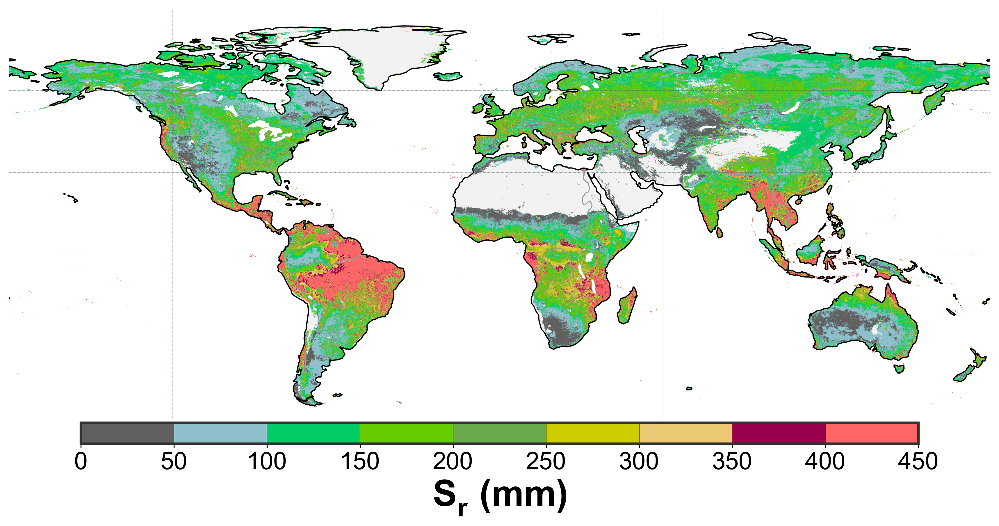

In [72]:
rgb_list = ['#606060','#8ec0cb','#00CC66','#66CC00',
                                '#69aa4c','#CCCC00','#ebc874','#99004C','#FF6666']

name = [f'Sr', 'Sr', 'Sr', '$S_{r}$ (mm)']
level = np.arange(0,500,50)
cmap = colors.ListedColormap(rgb_list)
draw(df1,name,level,cmap)

/tmp/ipykernel_649194/1383078795.py:65: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


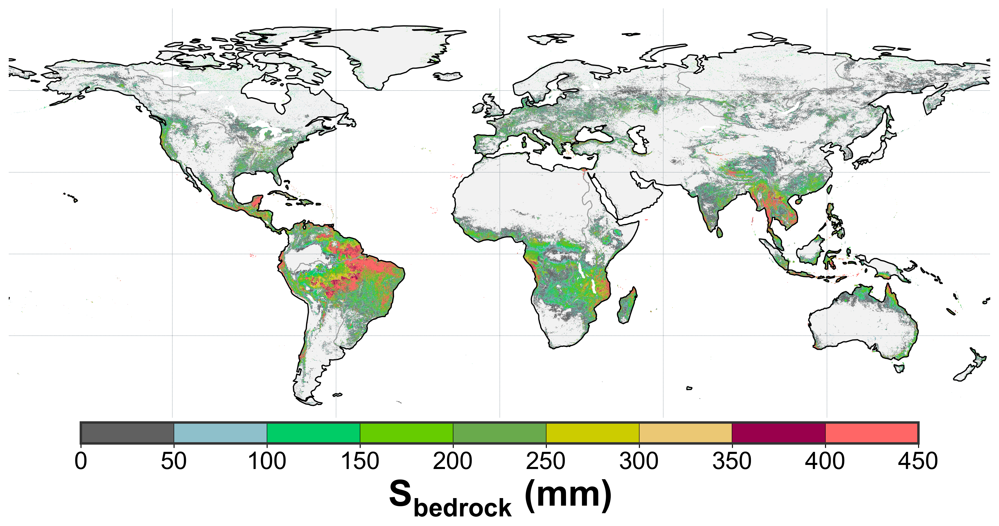

In [73]:
rgb_list = ['#606060','#8ec0cb','#00CC66','#66CC00',
                                '#69aa4c','#CCCC00','#ebc874','#99004C','#FF6666']

name = [f'Sbedrock', 'Sbedrock', 'Sbedrock', '$S_{bedrock}$ (mm)']
level = np.arange(0,500,50)
cmap = colors.ListedColormap(rgb_list)
draw(df1,name,level,cmap)

/tmp/ipykernel_649194/1383078795.py:65: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


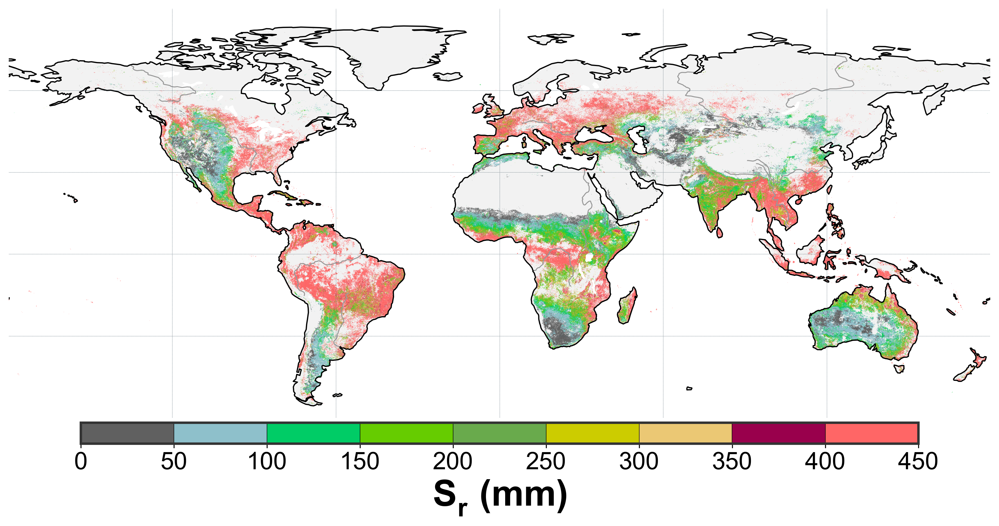

In [74]:
rgb_list = ['#606060','#8ec0cb','#00CC66','#66CC00',
                                '#69aa4c','#CCCC00','#ebc874','#99004C','#FF6666']

name = [f'SdSIF_QC', 'S0', 'Sr', '$S_{r}$ (mm)']
level = np.arange(0,500,50)
cmap = colors.ListedColormap(rgb_list)
draw(df1,name,level,cmap)

/tmp/ipykernel_649194/1383078795.py:65: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


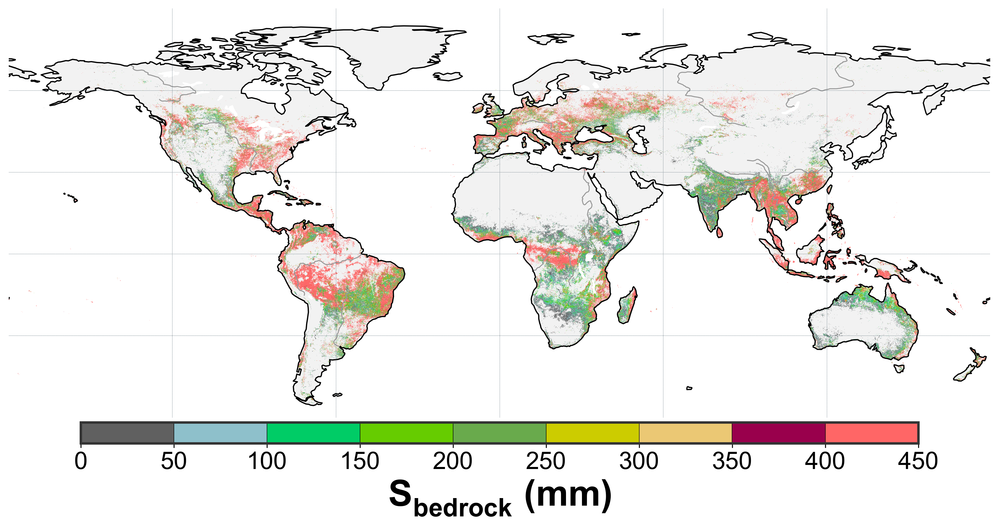

In [75]:
rgb_list = ['#606060','#8ec0cb','#00CC66','#66CC00',
                                '#69aa4c','#CCCC00','#ebc874','#99004C','#FF6666']

name = [f'Sbedrock_dSIF', 'S0', 'Sbedrock', '$S_{bedrock}$ (mm)']
level = np.arange(0,500,50)
cmap = colors.ListedColormap(rgb_list)
draw(df1,name,level,cmap)

/tmp/ipykernel_649194/1383078795.py:65: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


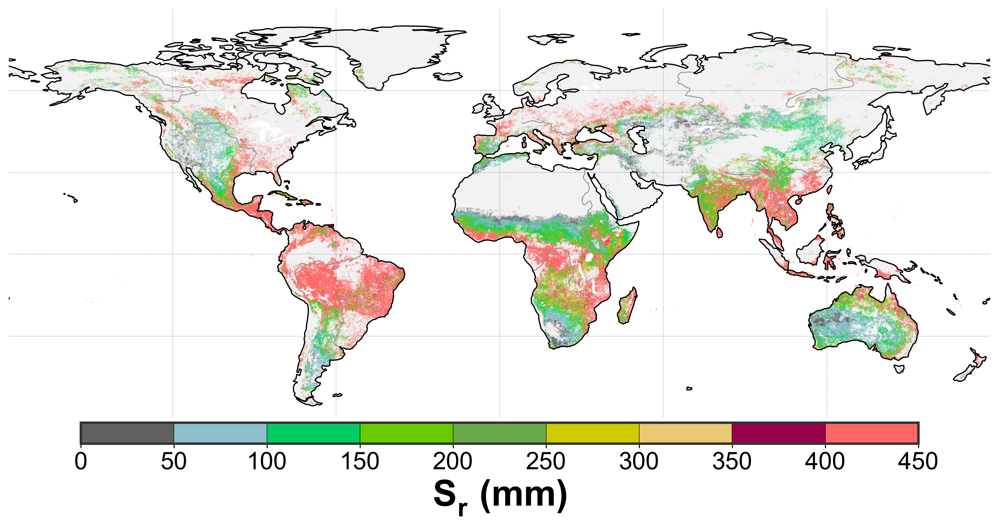

In [76]:
rgb_list = ['#606060','#8ec0cb','#00CC66','#66CC00',
                                '#69aa4c','#CCCC00','#ebc874','#99004C','#FF6666']

name = [f'SdEF_QC', 'S0', 'Sr', '$S_{r}$ (mm)']
level = np.arange(0,500,50)
cmap = colors.ListedColormap(rgb_list)
draw(df1,name,level,cmap)

/tmp/ipykernel_649194/1383078795.py:65: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


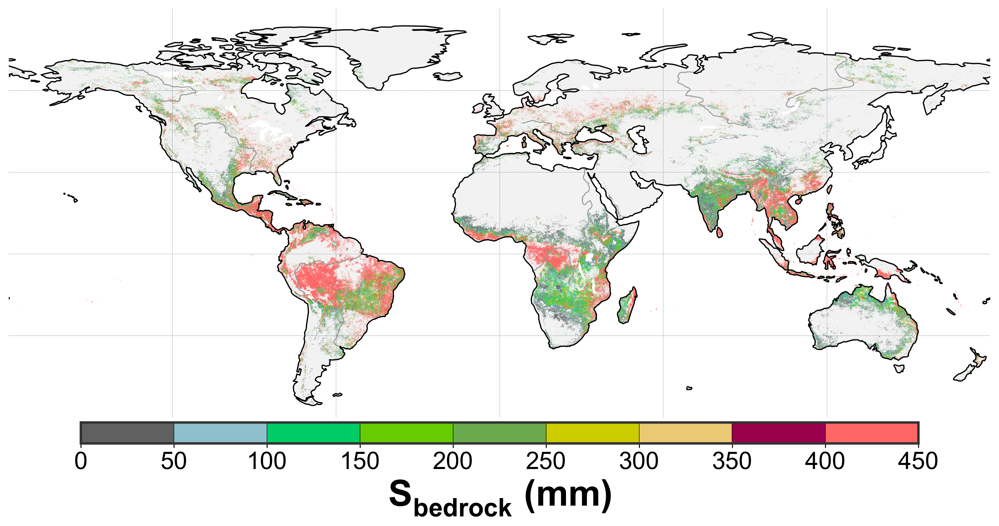

In [77]:
rgb_list = ['#606060','#8ec0cb','#00CC66','#66CC00',
                                '#69aa4c','#CCCC00','#ebc874','#99004C','#FF6666']

name = [f'Sbedrock_dEF', 'S0', 'Sbedrock', '$S_{bedrock}$ (mm)']
level = np.arange(0,500,50)
cmap = colors.ListedColormap(rgb_list)
draw(df1,name,level,cmap)

/tmp/ipykernel_649194/1383078795.py:65: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


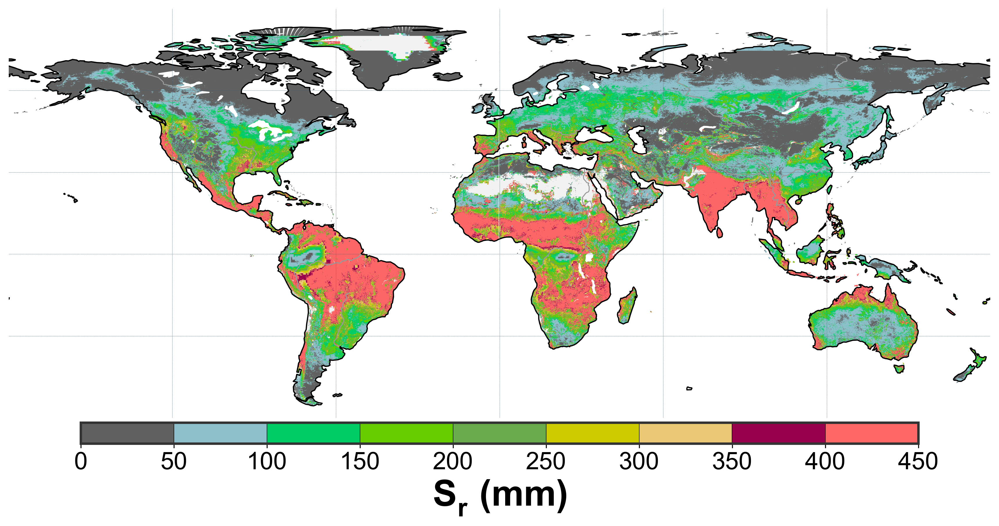

In [78]:
rgb_list = ['#606060','#8ec0cb','#00CC66','#66CC00',
                                '#69aa4c','#CCCC00','#ebc874','#99004C','#FF6666']

name = [f'Scwdx80', 'cwdx80', 'Sr', '$S_{r}$ (mm)']
level = np.arange(0,500,50)
cmap = colors.ListedColormap(rgb_list)
draw(df1,name,level,cmap)

/tmp/ipykernel_649194/1383078795.py:65: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


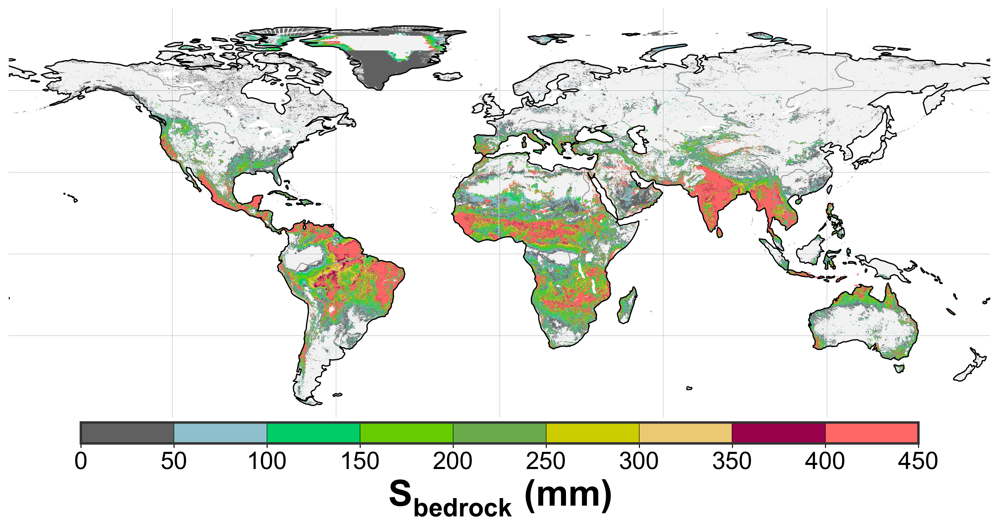

In [79]:
rgb_list = ['#606060','#8ec0cb','#00CC66','#66CC00',
                                '#69aa4c','#CCCC00','#ebc874','#99004C','#FF6666']

name = [f'Sbedrock_Stocker', 'cwdx80', 'Sbedrock', '$S_{bedrock}$ (mm)']
level = np.arange(0,500,50)
cmap = colors.ListedColormap(rgb_list)
draw(df1,name,level,cmap)